In [1]:
pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 3.4 MB/s eta 0:00:00


In [2]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=825b2ffad5db4928a30715019f0c355bcdbd6a695adcd7b362a7be05fa1a54b0
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [3]:
pip install dalex

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for dalex: filename=dalex-1.7.0-py3-none-any.whl size=1042471 sha256=a59d90eacb730d12f54834cb36439f0afbfd943a94a7f024fcafde5b979f500c
  Stored in directory: /root/.cache/pip/wheels/e2/38/c1/25a95206a4873a287d776fc8e77aa7d93971acc643ecb3db38
Successfully built dalex


In [4]:
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.metrics import classification_report, precision_recall_fscore_support, roc_auc_score,roc_curve
from sklearn.tree import DecisionTreeClassifier
from sklearn.impute import SimpleImputer
import shap
import lime
import lime.lime_tabular
import dalex as dx

In [5]:
import pandas as pd

# Load the dataset
columns = ['Age', 'Gender', 'Total_Bilirubin', 'Direct_Bilirubin',
       'Alkaline_Phosphotase', 'Alamine_Aminotransferase',
       'Aspartate_Aminotransferase', 'Total_Protiens', 'Albumin',
       'Albumin_and_Globulin_Ratio', 'Dataset']
data = pd.read_csv("indian_liver_patient.csv", header=0,names=columns)

# Display basic information about the dataset
print("Shape of the dataset:", data.shape)
print("\nData types of columns:")
print(data.dtypes)
print("\nPreview of the first few rows:")
print(data.head())
print("\nSummary statistics:")
print(data.describe())


Shape of the dataset: (583, 11)

Data types of columns:
Age                             int64
Gender                         object
Total_Bilirubin               float64
Direct_Bilirubin              float64
Alkaline_Phosphotase            int64
Alamine_Aminotransferase        int64
Aspartate_Aminotransferase      int64
Total_Protiens                float64
Albumin                       float64
Albumin_and_Globulin_Ratio    float64
Dataset                         int64
dtype: object

Preview of the first few rows:
   Age  Gender  Total_Bilirubin  Direct_Bilirubin  Alkaline_Phosphotase  \
0   65  Female              0.7               0.1                   187   
1   62    Male             10.9               5.5                   699   
2   62    Male              7.3               4.1                   490   
3   58    Male              1.0               0.4                   182   
4   72    Male              3.9               2.0                   195   

   Alamine_Aminotransferase  

In [ ]:
# Identifying Missing Values
# Exclude "Pregnancies" column from identifying missing values represented as zero
missing_values = (data[[col for col in data.columns]] == 0).sum()
print("\nMissing values")
print(missing_values)


Missing values
Age                           0
Gender                        0
Total_Bilirubin               0
Direct_Bilirubin              0
Alkaline_Phosphotase          0
Alamine_Aminotransferase      0
Aspartate_Aminotransferase    0
Total_Protiens                0
Albumin                       0
Albumin_and_Globulin_Ratio    0
Dataset                       0
dtype: int64


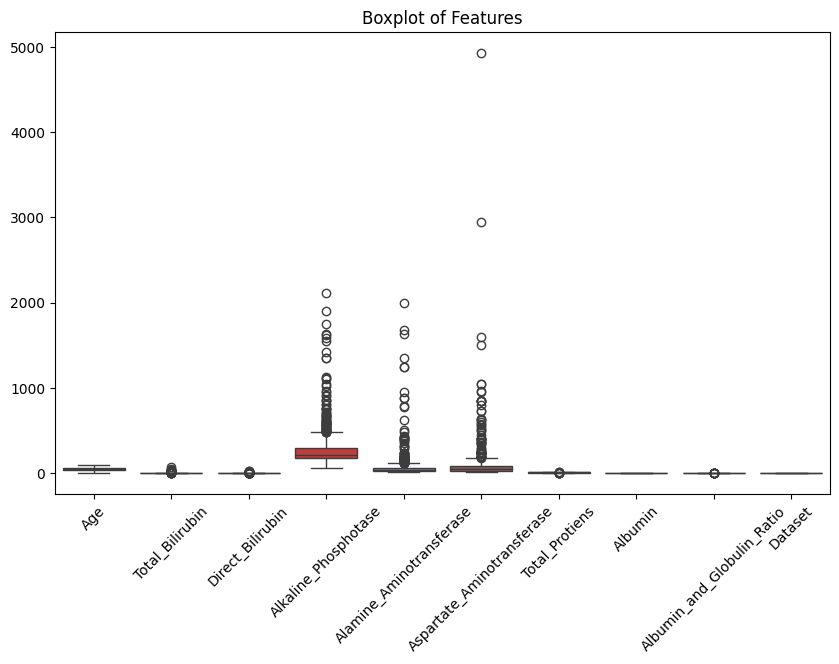

In [ ]:
# Identify outliers using boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(data=data)
plt.title("Boxplot of Features")
plt.xticks(rotation=45)
plt.show()


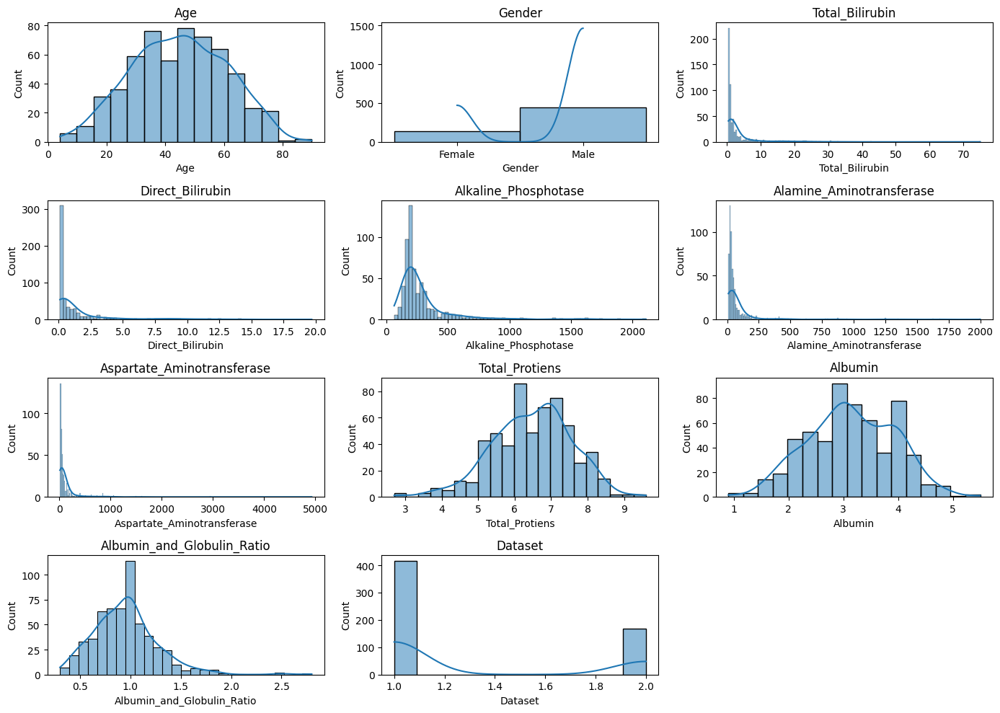

In [ ]:
# Visualize distributions of features
plt.figure(figsize=(14, 10))
for i, column in enumerate(data.columns, 1):
    plt.subplot(4, 3, i)
    sns.histplot(data[column], kde=True)
    plt.title(column)
plt.tight_layout()
plt.show()


<ipython-input-12-0110359a688f>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = data.corr()


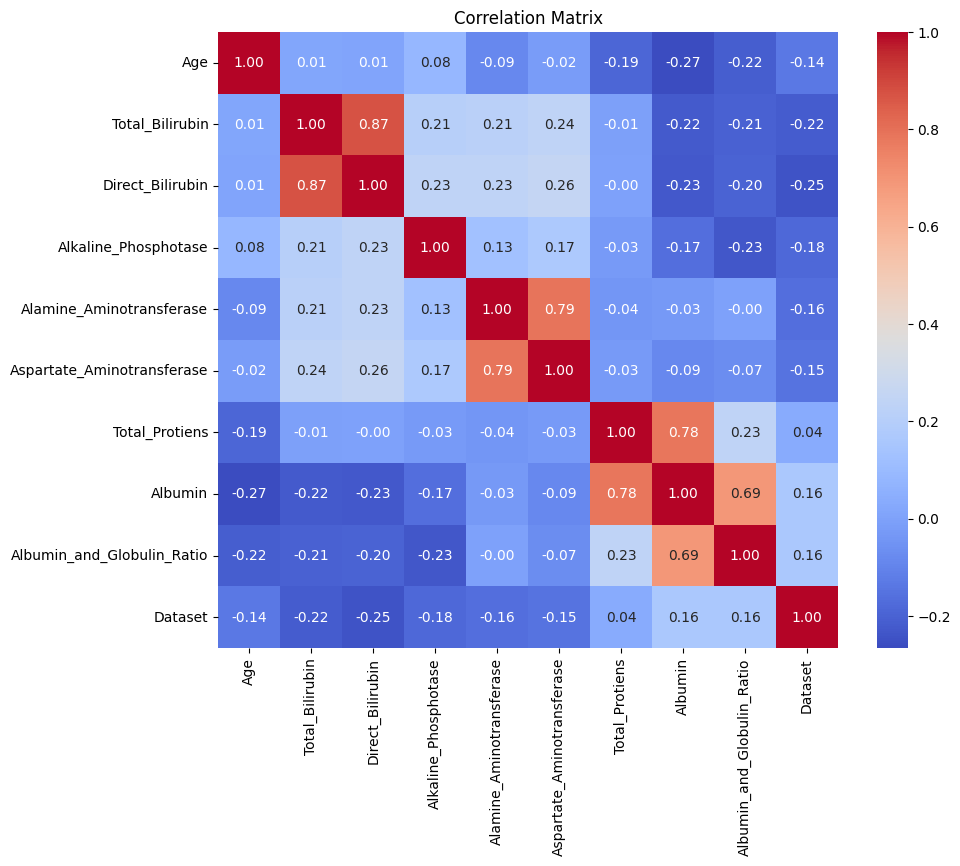

In [ ]:
# Calculate correlations
correlation_matrix = data.corr()

# Visualize correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")
plt.show()


In [ ]:
#Scaling Dataset
# Perform Min-Max scaling on the dataset
columns_to_scale = [col for col in data.columns if col not in ["Gender", "Dataset"]]
scaler = MinMaxScaler()
data_scaled = pd.DataFrame(scaler.fit_transform(data[columns_to_scale]), columns=columns_to_scale)

# Combine the scaled data with the "gender" column
data_scaled["Gender"] = data["Gender"]
data_scaled["Dataset"] = data["Dataset"]
# Display scaled dataset
print("Scaled dataset:")
print(data_scaled.head())

Scaled dataset:
        Age  Total_Bilirubin  Direct_Bilirubin  Alkaline_Phosphotase  \
0  0.709302         0.004021          0.000000              0.060576   
1  0.674419         0.140751          0.275510              0.310699   
2  0.674419         0.092493          0.204082              0.208598   
3  0.627907         0.008043          0.015306              0.058134   
4  0.790698         0.046917          0.096939              0.064485   

   Alamine_Aminotransferase  Aspartate_Aminotransferase  Total_Protiens  \
0                  0.003015                    0.001626        0.594203   
1                  0.027136                    0.018296        0.695652   
2                  0.025126                    0.011791        0.623188   
3                  0.002010                    0.002033        0.594203   
4                  0.008543                    0.009961        0.666667   

    Albumin  Albumin_and_Globulin_Ratio  Gender  Dataset  
0  0.521739                       0.240  

In [6]:
feature_names=['Age', 'Total_Bilirubin', 'Direct_Bilirubin','Alkaline_Phosphotase', 'Alamine_Aminotransferase','Aspartate_Aminotransferase', 'Total_Protiens', 'Albumin','Albumin_and_Globulin_Ratio']

In [7]:
# Assuming you have already loaded the dataset into X and y
X = data.drop(columns=['Dataset','Gender'])
y = data['Dataset']

# Impute missing values with the mean
imputer = SimpleImputer(strategy='mean')
X_imputed = imputer.fit_transform(X)
X_imputed = pd.DataFrame(X_imputed, columns=feature_names)
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_imputed, y, test_size=0.2, random_state=42)
# Initialize and train Logistic Regression model
logistic_regression = LogisticRegression(max_iter=1000)
logistic_regression.fit(X_train, y_train)

# Predict on the test set
y_pred_logreg = logistic_regression.predict(X_test)

# Calculate accuracy
accuracy_logreg = accuracy_score(y_test, y_pred_logreg)
print("Accuracy of Logistic Regression:", accuracy_logreg)

# Get the value of C used in the Logistic Regression model
# Get all parameters of the Logistic Regression model
params = logistic_regression.get_params()
# Extract the value of C
c_value = params['C']
print("Value of C used in Logistic Regression model:", c_value)



Accuracy of Logistic Regression: 0.7606837606837606
Value of C used in Logistic Regression model: 1.0


In [8]:
# Initialize models
knn = KNeighborsClassifier()

# Train KNN model
knn.fit(X_train, y_train)

# Predict on the test set
y_pred_knn = knn.predict(X_test)

# Calculate accuracy
accuracy_knn = accuracy_score(y_test, y_pred_knn)
print("Accuracy of k-Nearest Neighbors (KNN):", accuracy_knn)

# Get the value of k used in the KNN model
k_value = knn.n_neighbors
print("Value of k used in KNN model:", k_value)


Accuracy of k-Nearest Neighbors (KNN): 0.6837606837606838
Value of k used in KNN model: 5


In [9]:
# Further split training data into training and validation sets (80% train, 20% validation)
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

# Define hyperparameter grids for Logistic Regression and KNN
param_grid_logreg = {'C': [0.001, 0.01, 0.1, 1, 10, 100]}
param_grid_knn = {'n_neighbors': [3, 5, 7, 9, 11]}

# Initialize GridSearchCV for Logistic Regression and KNN without cross-validation
grid_search_logreg = GridSearchCV(LogisticRegression(max_iter=1000), param_grid_logreg)
grid_search_knn = GridSearchCV(KNeighborsClassifier(), param_grid_knn)

# Fit GridSearchCV on training data for Logistic Regression
grid_search_logreg.fit(X_train, y_train)

# Fit GridSearchCV on training data for KNN
grid_search_knn.fit(X_train, y_train)

# Get best hyperparameters and best scores
best_params_logreg = grid_search_logreg.best_params_
best_score_logreg = grid_search_logreg.best_score_

best_params_knn = grid_search_knn.best_params_
best_score_knn = grid_search_knn.best_score_

print("Best hyperparameters for Logistic Regression:", best_params_logreg)
print("Best accuracy score for Logistic Regression:", best_score_logreg)

print("\nBest hyperparameters for k-Nearest Neighbors (KNN):", best_params_knn)
print("Best accuracy score for k-Nearest Neighbors (KNN):", best_score_knn)


Best hyperparameters for Logistic Regression: {'C': 100}
Best accuracy score for Logistic Regression: 0.6988828828828828

Best hyperparameters for k-Nearest Neighbors (KNN): {'n_neighbors': 9}
Best accuracy score for k-Nearest Neighbors (KNN): 0.6828828828828828


In [10]:
# Initialize Logistic Regression and KNN classifiers with optimized hyperparameters
logistic_regression_optimized = LogisticRegression(**best_params_logreg,max_iter=1000)
knn_optimized = KNeighborsClassifier(**best_params_knn)

# Perform k-fold cross-validation (k=5) for both initial and optimized models
k_folds = 5
initial_models = [('Logistic Regression', logistic_regression), ('KNN', knn)]
optimized_models = [('Logistic Regression (Optimized)', logistic_regression_optimized),
                    ('KNN (Optimized)', knn_optimized)]

# Evaluate initial models
print("Performance of Initial Models:")
for name, model in initial_models:
    scores = cross_val_score(model, X_imputed, y, cv=k_folds, scoring='accuracy')
    print(f"{name}: Mean Accuracy: {scores.mean():.4f}, Standard Deviation: {scores.std():.4f}")

# Evaluate optimized models
print("\nPerformance of Optimized Models:")
for name, model in optimized_models:
    scores = cross_val_score(model, X_imputed, y, cv=k_folds, scoring='accuracy')
    print(f"{name}: Mean Accuracy: {scores.mean():.4f}, Standard Deviation: {scores.std():.4f}")


Performance of Initial Models:
Logistic Regression: Mean Accuracy: 0.7153, Standard Deviation: 0.0095
KNN: Mean Accuracy: 0.6638, Standard Deviation: 0.0514

Performance of Optimized Models:
Logistic Regression (Optimized): Mean Accuracy: 0.7290, Standard Deviation: 0.0131
KNN (Optimized): Mean Accuracy: 0.6878, Standard Deviation: 0.0631


In [11]:
# Define regularization strength values (C values)
C_values = [0.001, 0.01, 0.1, 1, 10, 100]

# Initialize Logistic Regression models with L1 and L2 regularization
logreg_l1 = LogisticRegressionCV(max_iter=1000,Cs=C_values, cv=5, penalty='l1', solver='liblinear')
logreg_l2 = LogisticRegressionCV(max_iter=1000,Cs=C_values, cv=5, penalty='l2', solver='lbfgs')

# Fit models on training data
logreg_l1.fit(X_train, y_train)
logreg_l2.fit(X_train, y_train)

# Evaluate performance on training and validation sets
accuracy_train_l1 = logreg_l1.score(X_train, y_train)
accuracy_val_l1 = logreg_l1.score(X_val, y_val)

accuracy_train_l2 = logreg_l2.score(X_train, y_train)
accuracy_val_l2 = logreg_l2.score(X_val, y_val)

print("Logistic Regression with L1 Regularization:")
print(f"Training Accuracy: {accuracy_train_l1:.4f}, Validation Accuracy: {accuracy_val_l1:.4f}")

print("\nLogistic Regression with L2 Regularization:")
print(f"Training Accuracy: {accuracy_train_l2:.4f}, Validation Accuracy: {accuracy_val_l2:.4f}")


Logistic Regression with L1 Regularization:
Training Accuracy: 0.7016, Validation Accuracy: 0.7553

Logistic Regression with L2 Regularization:
Training Accuracy: 0.7043, Validation Accuracy: 0.7872


In [12]:
# Initialize Random Forest and Gradient Boosting classifiers
random_forest = RandomForestClassifier(random_state=42)
gradient_boosting = GradientBoostingClassifier(random_state=42)

# Train Random Forest and Gradient Boosting classifiers on training data
random_forest.fit(X_train, y_train)
gradient_boosting.fit(X_train, y_train)

# Evaluate performance on testing set
accuracy_random_forest = random_forest.score(X_test, y_test)
accuracy_gradient_boosting = gradient_boosting.score(X_test, y_test)

print("Performance of Ensemble Models:")
print("Random Forest Accuracy:", accuracy_random_forest)
print("Gradient Boosting Accuracy:", accuracy_gradient_boosting)


Performance of Ensemble Models:
Random Forest Accuracy: 0.717948717948718
Gradient Boosting Accuracy: 0.7521367521367521


In [ ]:
print(y)

0      1
1      1
2      1
3      1
4      1
      ..
578    2
579    1
580    1
581    1
582    2
Name: Dataset, Length: 583, dtype: int64


                       Model  Accuracy  Precision    Recall  F1-score  \
0        Logistic Regression  0.743590   0.793814  0.885057  0.836957   
1  k-Nearest Neighbors (KNN)  0.692308   0.762887  0.850575  0.804348   
2              Random Forest  0.717949   0.787234  0.850575  0.817680   
3          Gradient Boosting  0.752137   0.808511  0.873563  0.839779   

    ROC AUC  
0  0.609195  
1  0.541954  
2  0.591954  
3  0.636782  


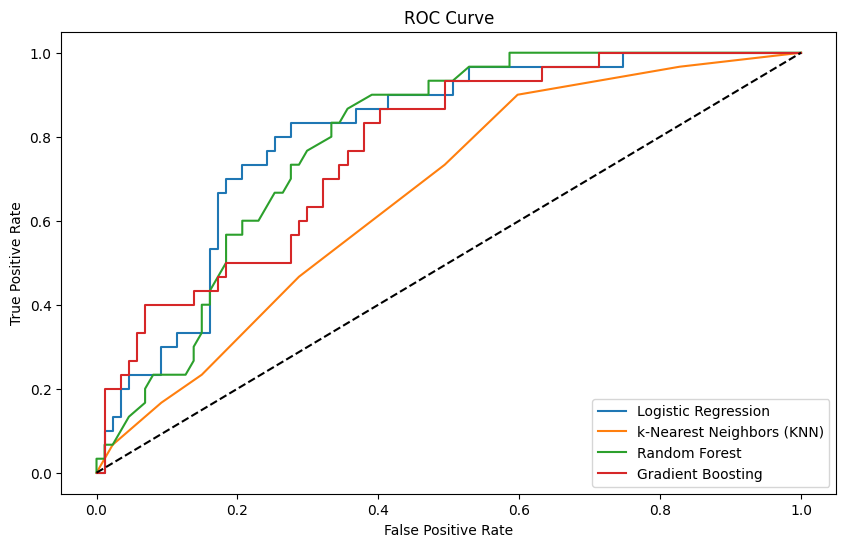

In [13]:
evaluation_metrics = []

# Defining models and their names
models = [
    ("Logistic Regression", logistic_regression_optimized),
    ("k-Nearest Neighbors (KNN)", knn_optimized),
    ("Random Forest", random_forest),
    ("Gradient Boosting", gradient_boosting)
]
# Evaluating each model
for name, model in models:
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision, recall, f1_score, _ = precision_recall_fscore_support(y_test, y_pred, average="binary")
    roc_auc = roc_auc_score(y_test, y_pred)
    evaluation_metrics.append((name, accuracy, precision, recall, f1_score, roc_auc))

metrics_df = pd.DataFrame(evaluation_metrics, columns=["Model", "Accuracy", "Precision", "Recall", "F1-score", "ROC AUC"])

# Display evaluation metrics
print(metrics_df)

# Plotting ROC AUC
plt.figure(figsize=(10, 6))
for name, model in models:
    y_pred_proba = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba,pos_label=2)
    plt.plot(fpr, tpr, label=name)

plt.plot([0, 1], [0, 1], linestyle='--', color='black')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()
plt.show()



In [14]:
# Prepare a subset of the data for explanation (e.g., first 100 samples)
X_explain = X_train[:100]
print(X_explain)

      Age  Total_Bilirubin  Direct_Bilirubin  Alkaline_Phosphotase  \
107  36.0              0.8               0.2                 158.0   
33   38.0              2.6               1.2                 410.0   
534  39.0              1.6               0.8                 230.0   
204  21.0              0.7               0.2                 135.0   
48   32.0              0.6               0.1                 176.0   
..    ...              ...               ...                   ...   
374  56.0              0.7               0.1                 145.0   
18   40.0              0.9               0.3                 293.0   
515  49.0              3.9               2.1                 189.0   
358  37.0              0.7               0.2                 176.0   
59   64.0              1.1               0.5                 145.0   

     Alamine_Aminotransferase  Aspartate_Aminotransferase  Total_Protiens  \
107                      29.0                        39.0             6.0   
33   

In [25]:
shap.initjs()

In [26]:
# Initialize the SHAP explainer
explainer = shap.KernelExplainer(logistic_regression_optimized.predict, X_explain)

In [27]:
# Calculate SHAP values
shap_values = explainer.shap_values(X_explain)


  0%|          | 0/100 [00:00<?, ?it/s]

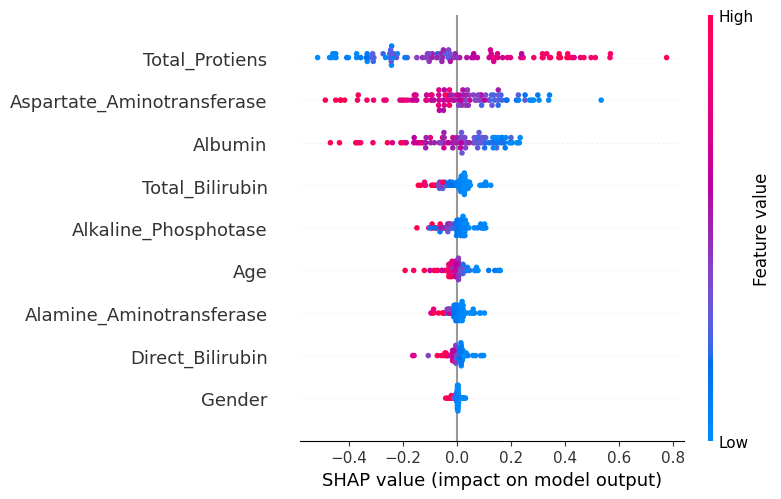

In [ ]:
# Plot the SHAP values
shap.summary_plot(shap_values, X_explain, feature_names=columns)


In [ ]:
col=columns.remove("Gender")

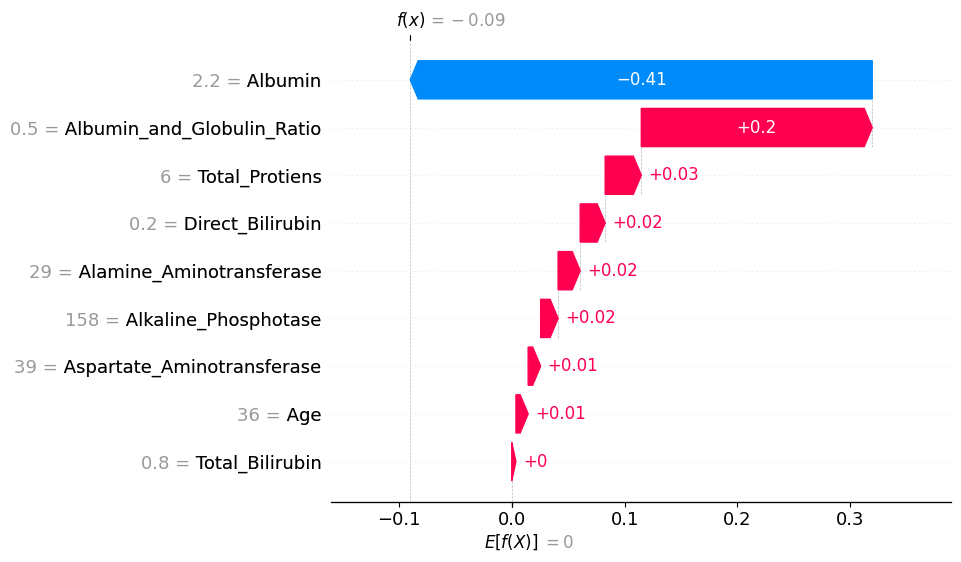

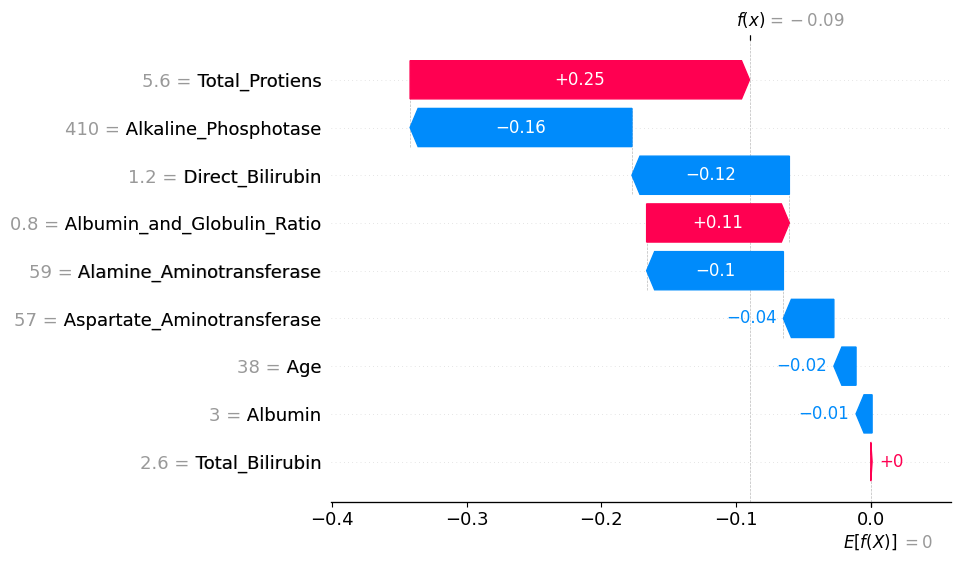

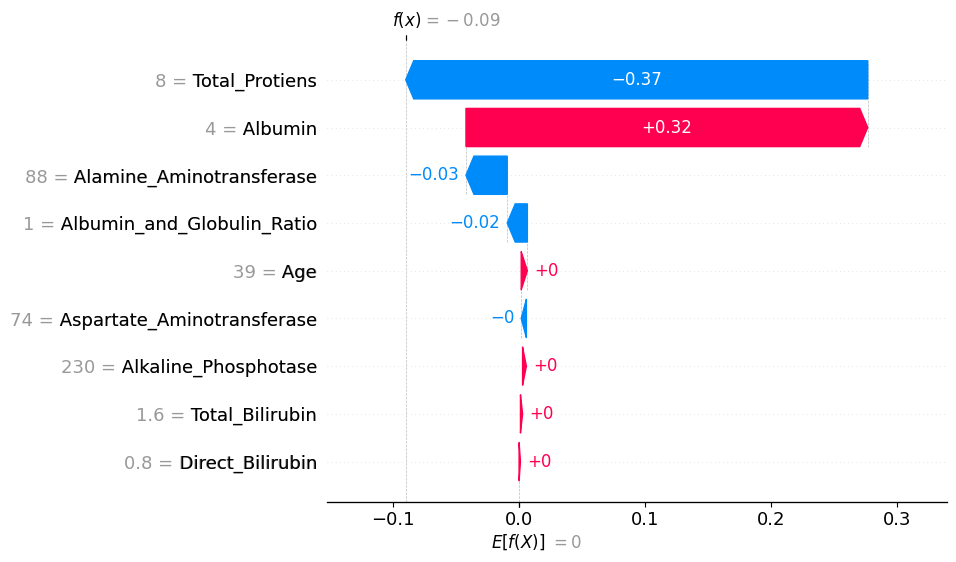

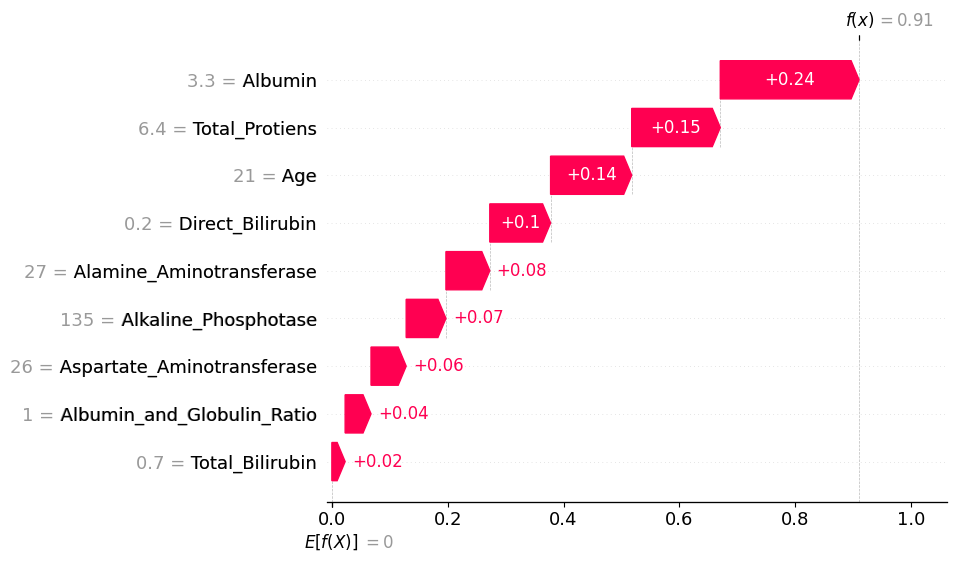

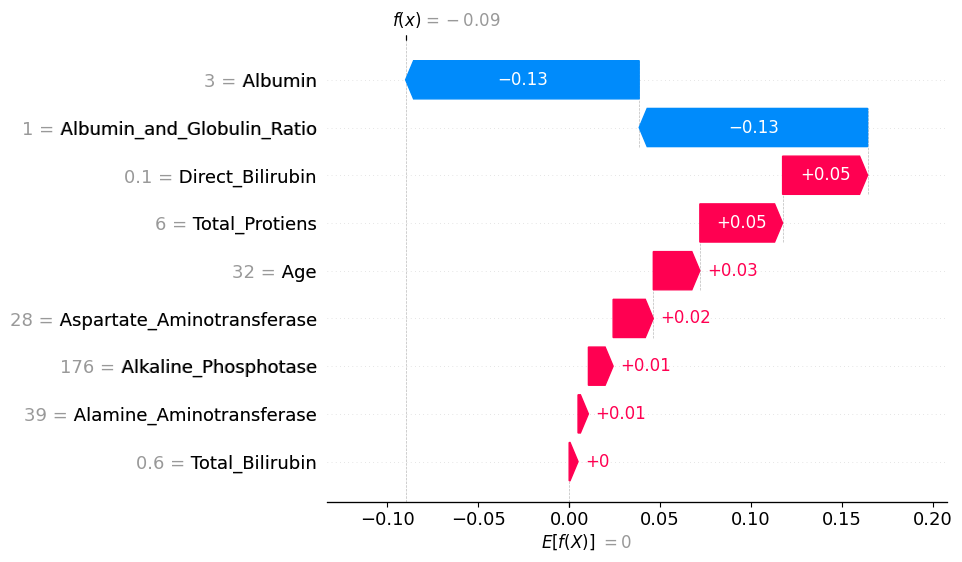

...

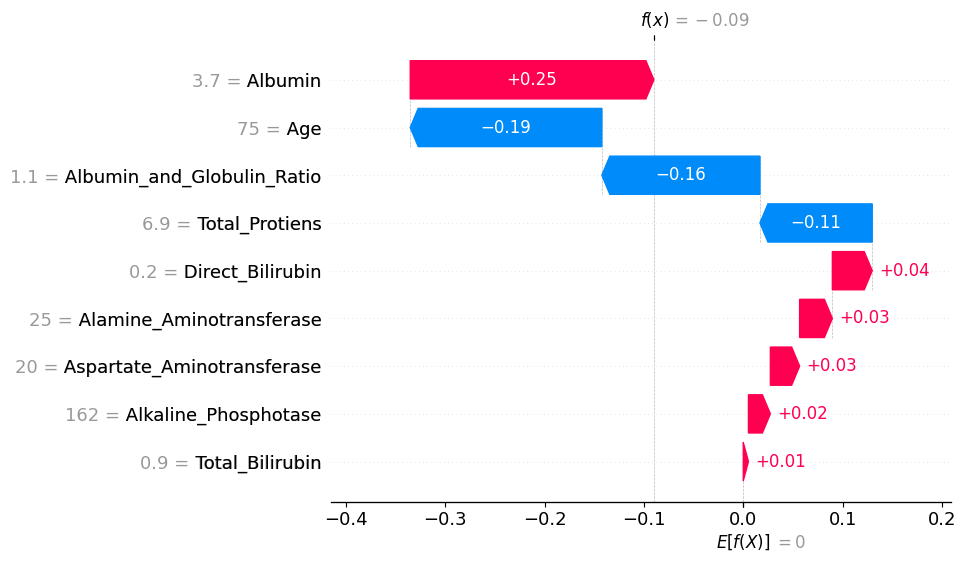

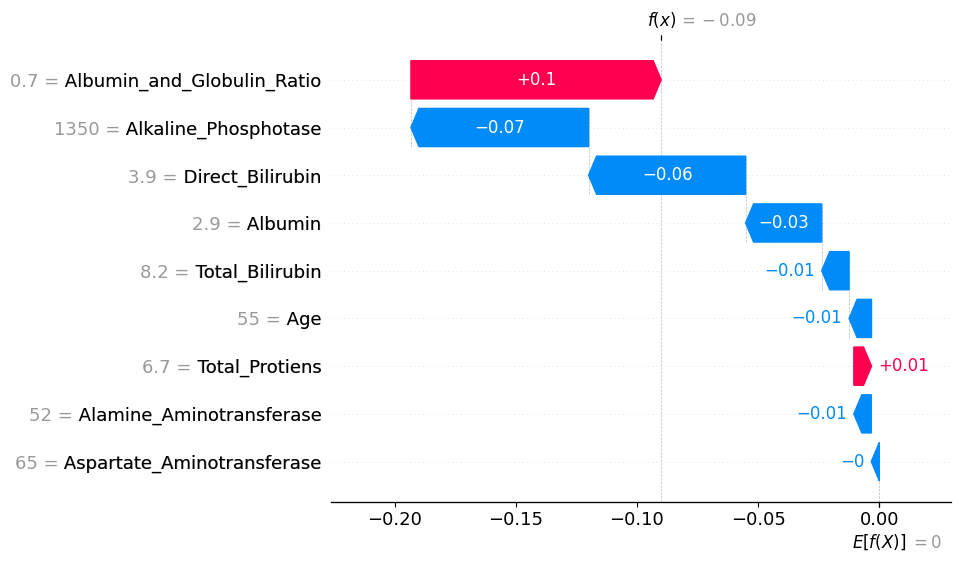

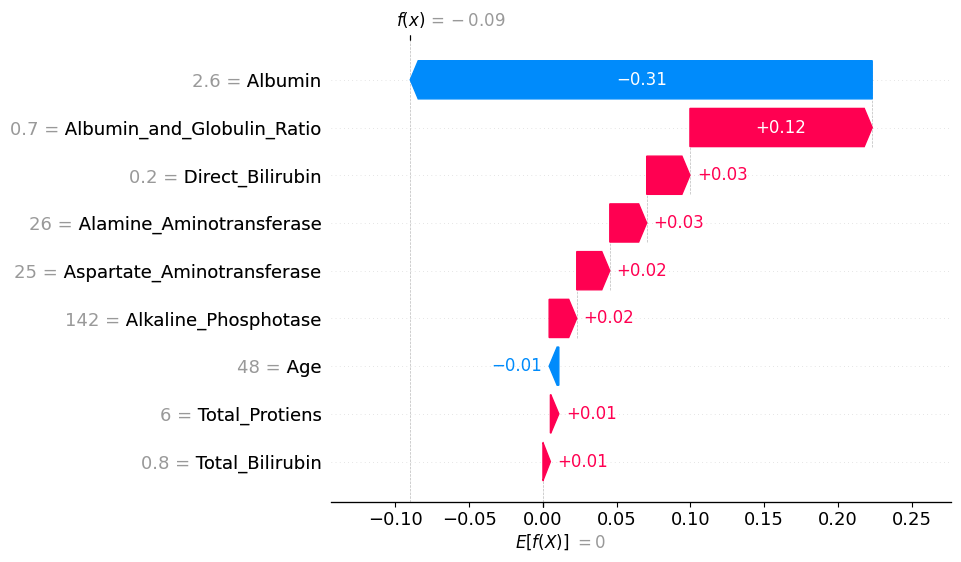

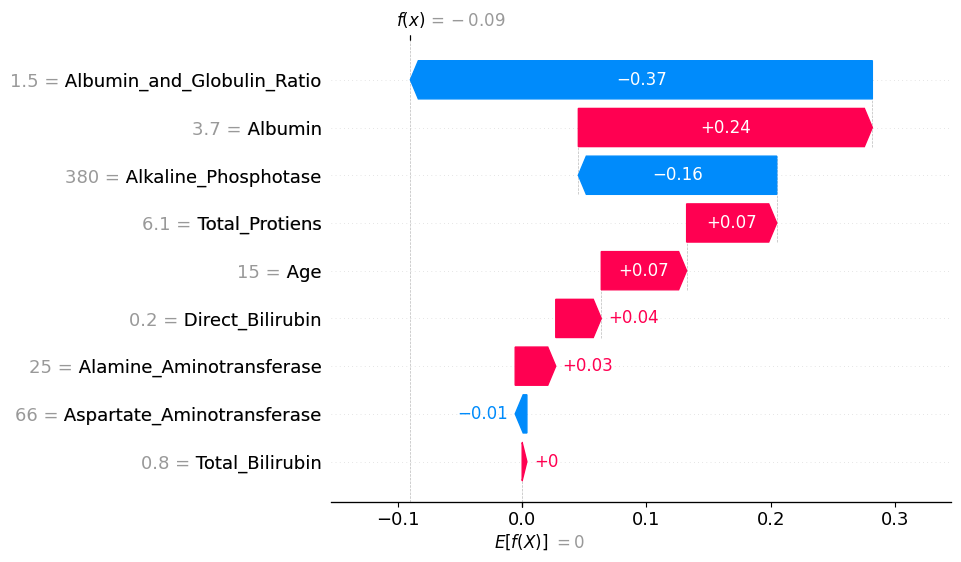

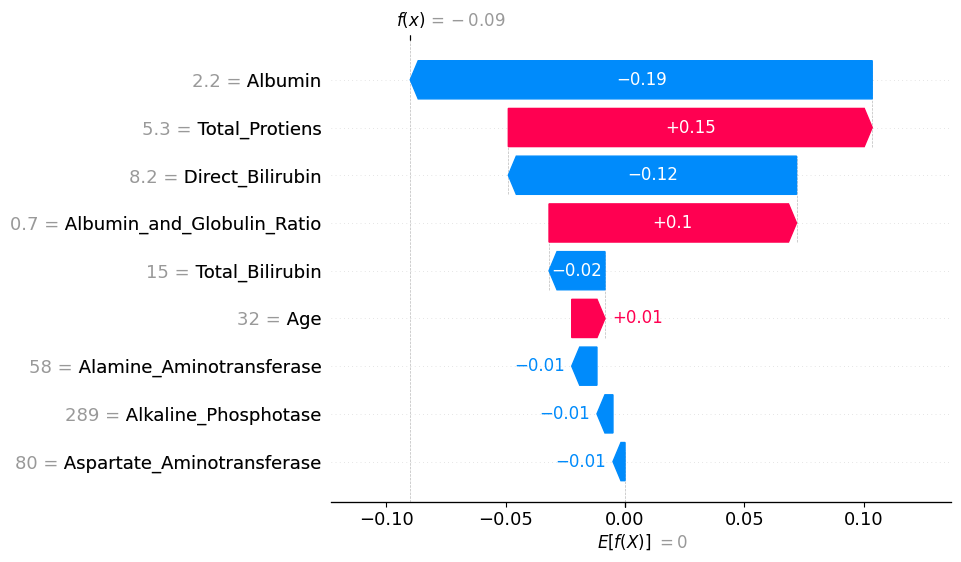

<Figure size 640x480 with 0 Axes>

In [ ]:
import matplotlib.pyplot as plt

# Number of instances to explain
num_instances = 12

plt.figure(figsize=(40, 10))
# Loop through each instance
for i in range(num_instances):
    # Create an Explanation object
    expl = shap.Explanation(values=shap_values[i],
                            data=X_explain.iloc[i],
                            feature_names=['Age', 'Total_Bilirubin', 'Direct_Bilirubin',
                                           'Alkaline_Phosphotase', 'Alamine_Aminotransferase',
                                           'Aspartate_Aminotransferase', 'Total_Protiens', 'Albumin',
                                           'Albumin_and_Globulin_Ratio', 'Dataset'])

    # Set base_values attribute
    expl.base_values = np.mean(shap_values)
    # Plot the waterfall plot
    shap.plots.waterfall(expl)

plt.tight_layout()
plt.show()


In [28]:
expected_value = explainer.expected_value

# Plot the force plot
shap.plots.force(expected_value, shap_values)

In [15]:
col=columns.remove("Dataset")

In [ ]:
# Importing the module for LimeTabularExplainer
from lime import lime_tabular

# Instantiating the explainer object by passing in the training set,
# and the extracted features
# Convert the NumPy array X_train to a DataFrame
X_train_df = pd.DataFrame(X_train, columns=col)

X_train_df.reset_index(drop=True, inplace=True)

# Make sure that the feature names (col) match the columns of your DataFrame
col = X_train_df.columns.tolist()

# Instantiate the explainer object by passing in the DataFrame
explainer = lime.lime_tabular.LimeTabularExplainer(X_train_df.values,
                                                   feature_names=['Age', 'Gender', 'Total_Bilirubin', 'Direct_Bilirubin','Alkaline_Phosphotase', 'Alamine_Aminotransferase','Aspartate_Aminotransferase', 'Total_Protiens', 'Albumin','Albumin_and_Globulin_Ratio'],
                                                   class_names=['class_0', 'class_1'],
                                                   mode='classification')




In [ ]:
import matplotlib.pyplot as plt

# Number of instances to explain
num_instances = 12


# Loop through each instance
for i in range(num_instances):
    # Choose a specific instance
    instance = X_test.iloc[i]

    # Explain the prediction for the instance
    explanation = explainer.explain_instance(instance, model.predict_proba)

    # Plot the explanation in the corresponding subplot
    explanation.show_in_notebook()



In [16]:
explainer = dx.Explainer(logistic_regression, X_train, y_train, label="Logistic Regression")

Preparation of a new explainer is initiated

  -> data              : 372 rows 9 cols
  -> target variable   : Parameter 'y' was a pandas.Series. Converted to a numpy.ndarray.
  -> target variable   : 372 values
  -> model_class       : sklearn.linear_model._logistic.LogisticRegression (default)
  -> label             : Logistic Regression
  -> predict function  : <function yhat_proba_default at 0x7c3467773d00> will be used (default)
  -> predict function  : Accepts pandas.DataFrame and numpy.ndarray.
  -> predicted values  : min = 2.44e-13, mean = 0.298, max = 0.656
  -> model type        : classification will be used (default)
  -> residual function : difference between y and yhat (default)
  -> residuals         : min = 0.344, mean = 1.01, max = 1.99
  -> model_info        : package sklearn

A new explainer has been created!


In [17]:
fi = explainer.model_parts().plot()

In [18]:
num_instances = 12


# Loop through each instance
for i in range(num_instances):
    # Choose a specific instance
    instance = X_test.iloc[0, :]

    # Explain the prediction for the instance
    pp = explainer.predict_parts(instance).plot()


In [19]:
mp = explainer.model_performance().result

In [20]:
pd_plot = explainer.model_profile(variables=["Albumin"])

# Plot partial dependence plot
pd_plot.plot()

Calculating ceteris paribus: 100%|██████████| 1/1 [00:00<00:00, 146.09it/s]


In [21]:
pdp_num = explainer.model_profile(type = 'partial', label="pdp")

Calculating ceteris paribus: 100%|██████████| 9/9 [00:00<00:00, 155.32it/s]


In [22]:
ale_num = explainer.model_profile(type = 'accumulated', label="ale")

Calculating accumulated dependency: 100%|██████████| 9/9 [00:00<00:00, 11.74it/s]


In [23]:
pdp_num.plot(ale_num)